In [1]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import ResNet50,VGG19,VGG16
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.models import Sequential

In [2]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Set paths and parameters
data_path = "DataSets/AirCrafts"#'crop'
image_size = (224, 224)  # Resize images to match model input size
batch_size = 32

# Create ImageDataGenerator instance
datagen = ImageDataGenerator(rescale=1.0 / 255.0, validation_split=0.2)

# Load training and validation sets
train_data = datagen.flow_from_directory(
    directory=data_path,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

val_data = datagen.flow_from_directory(
    directory=data_path,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

Found 25565 images belonging to 74 classes.
Found 6352 images belonging to 74 classes.


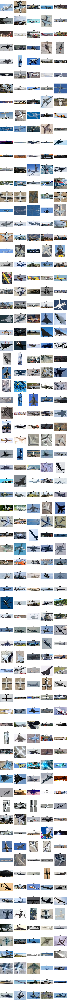

In [4]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Set the main directory where your class folders are located
main_dir = "DataSets/AirCrafts"#'crop'

# List all class directories
class_folders = [os.path.join(main_dir, class_dir) for class_dir in os.listdir(main_dir) if os.path.isdir(os.path.join(main_dir, class_dir))]

# Sort the folders to ensure the order is consistent
class_folders.sort()

# Create a figure to hold all subplots
fig, axes = plt.subplots(len(class_folders), 5, figsize=(15, len(class_folders) * 3))

# Loop through each class folder
for i, class_folder in enumerate(class_folders):
    # Get the folder name (fighter jet class name)
    folder_name = os.path.basename(class_folder)
    
    # List all images in the current class folder
    images = [img for img in os.listdir(class_folder) if img.endswith(('.png', '.jpg', '.jpeg'))]
    
    # Randomly select 5 images if there are at least 5, otherwise select all available
    selected_images = random.sample(images, 5) if len(images) >= 5 else images
    
    # Loop through the 5 selected images and display each one
    for j in range(5):
        ax = axes[i, j]  # Select subplot
        if j < len(selected_images):
            img_path = os.path.join(class_folder, selected_images[j])
            img = mpimg.imread(img_path)  # Load the image
            ax.imshow(img)
            ax.set_title(folder_name)  # Title with folder_name, from which this perticular image belongs.
        else:
            ax.axis('off')  # Turn off axis for empty slots
    
        # Turn off axis ticks for all subplots
        ax.axis('off')

plt.tight_layout()
plt.show()


In [6]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical

# Define the path to the dataset folder
data_dir = "DataSets/AirCrafts"#'crop'  # Replace with the path to your 'crop' folder

# Set image parameters
img_height, img_width = 224, 224  # Image dimensions to resize
batch_size = 32  # Batch size

# Initialize ImageDataGenerator for data augmentation
train_datagen = ImageDataGenerator(
    rescale=1.0/255,            # Normalize pixel values
    rotation_range=20,           # Random rotation
    width_shift_range=0.2,       # Random horizontal shift
    height_shift_range=0.2,      # Random vertical shift
    shear_range=0.2,             # Shear transformation
    zoom_range=0.2,              # Zoom in/out
    horizontal_flip=True,        # Horizontal flip
    fill_mode='nearest',         # Fill in newly created pixels
    validation_split=0.2         # Reserve 20% of data for validation
)

# Load training and validation sets using flow_from_directory
train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='sparse',         # Use sparse for integer labels
    subset='training',           # Set as training data
    shuffle=True                 # Shuffle for randomness
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='sparse',         # Use sparse for integer labels
    subset='validation'          # Set as validation data
)

# Print class indices to verify folder-label mapping
print("Class labels mapping:", train_generator.class_indices)


Found 25565 images belonging to 74 classes.
Found 6352 images belonging to 74 classes.
Class labels mapping: {'A10': 0, 'A400M': 1, 'AG600': 2, 'AH64': 3, 'AV8B': 4, 'An124': 5, 'An22': 6, 'An225': 7, 'An72': 8, 'B1': 9, 'B2': 10, 'B21': 11, 'B52': 12, 'Be200': 13, 'C130': 14, 'C17': 15, 'C2': 16, 'C390': 17, 'C5': 18, 'CH47': 19, 'CL415': 20, 'E2': 21, 'E7': 22, 'EF2000': 23, 'F117': 24, 'F14': 25, 'F15': 26, 'F16': 27, 'F18': 28, 'F22': 29, 'F35': 30, 'F4': 31, 'H6': 32, 'J10': 33, 'J20': 34, 'JAS39': 35, 'JF17': 36, 'JH7': 37, 'KC135': 38, 'KF21': 39, 'KJ600': 40, 'Ka27': 41, 'Ka52': 42, 'MQ9': 43, 'Mi24': 44, 'Mi26': 45, 'Mi28': 46, 'Mig29': 47, 'Mig31': 48, 'Mirage2000': 49, 'P3': 50, 'RQ4': 51, 'Rafale': 52, 'SR71': 53, 'Su24': 54, 'Su25': 55, 'Su34': 56, 'Su57': 57, 'TB001': 58, 'TB2': 59, 'Tornado': 60, 'Tu160': 61, 'Tu22M': 62, 'Tu95': 63, 'U2': 64, 'UH60': 65, 'US2': 66, 'V22': 67, 'Vulcan': 68, 'WZ7': 69, 'XB70': 70, 'Y20': 71, 'YF23': 72, 'Z19': 73}


In [7]:
from tensorflow.keras import layers, Sequential
import tensorflow as tf

# Define the model
model = Sequential()

# Convolutional layers with LeakyReLU, Batch Normalization, and Dropout
model.add(layers.Conv2D(32, (3, 3), input_shape=(224, 224, 3)))
model.add(tf.keras.layers.LeakyReLU(alpha=0.1))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(rate=0.3))

model.add(layers.Conv2D(64, (3, 3)))
model.add(tf.keras.layers.LeakyReLU(alpha=0.1))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Dropout(rate=0.3))

model.add(layers.Conv2D(64, (3, 3), activation='elu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(128, (3, 3), activation='elu'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Conv2D(128, (3, 3), activation='elu'))
model.add(layers.BatchNormalization())
model.add(layers.AvgPool2D((2, 2)))
model.add(layers.Dropout(rate=0.4))

model.add(layers.Conv2D(256, (3, 3), activation='elu'))
model.add(layers.BatchNormalization())

# Flatten and Dense layers with LeakyReLU, Batch Normalization, and Dropout
model.add(layers.Flatten())
model.add(layers.Dense(64))
model.add(tf.keras.layers.LeakyReLU(alpha=0.1))
model.add(layers.BatchNormalization())
model.add(layers.Dropout(rate=0.3))

model.add(layers.Dense(128))
model.add(tf.keras.layers.LeakyReLU(alpha=0.1))
model.add(layers.BatchNormalization())
model.add(layers.Dropout(rate=0.3))

model.add(layers.Dense(74, activation="softmax"))  # Output layer for 74 classes

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


D:\AnnA\envs\diat\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
D:\AnnA\envs\diat\Lib\site-packages\keras\src\layers\activations\leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [8]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 222, 222, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 109, 109, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 52, 52, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 24, 24, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 24, 24, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 10, 10, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 10, 10, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling2d               │ (None, 5, 5, 128)      │             0 │
│ (AveragePooling2D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 5, 5, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 3, 3, 256)      │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 3, 3, 256)      │         1,02

 Total params: 741,770 (2.83 MB)

 Trainable params: 740,042 (2.82 MB)

 Non-trainable params: 1,728 (6.75 KB)

In [ ]:
history = model.fit(
    train_generator,
    epochs=20,                          # Set the number of epochs
    validation_data=validation_generator
)


In [ ]:
import matplotlib.pyplot as plt

# Assuming 'history' is the result of model.fit
def plot_training_history(history):
    # Plot training & validation accuracy values
    plt.figure(figsize=(14, 5))

    # Plot accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')

    # Plot loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(loc='upper right')

    plt.show()

# Call the function after training
plot_training_history(history)


In [ ]:
# Define test data generator
test_datagen = ImageDataGenerator(rescale=1.0/255)  # Rescale for normalization

# Load test data
test_generator = test_datagen.flow_from_directory(
    data_dir,                            # Replace with the test directory path
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='sparse',
    shuffle=False
)

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy:.2f}")
print(f"Test Loss: {test_loss:.2f}")


In [ ]:
from tensorflow.keras.preprocessing import image
import numpy as np

def predict_image_class(model, img_path, class_indices):
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(img_height, img_width))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Expand dims to add batch size (1, height, width, channels)
    img_array /= 255.0  # Normalize

    # Predict class
    predictions = model.predict(img_array)
    predicted_class = np.argmax(predictions, axis=1)[0]

    # Map index to class name
    class_labels = {v: k for k, v in class_indices.items()}
    predicted_class_name = class_labels[predicted_class]

    print(f"Predicted class: {predicted_class_name}")
    return predicted_class_name

# Example usage
img_path = 'path/to/your/test_image.jpg'  # Replace with your test image path
predicted_class = predict_image_class(model, img_path, train_generator.class_indices)
